In [3]:
import os
import os.path
import random 

import numpy as np
import pandas as pd
import cv2 
import scipy

import matplotlib.pyplot as plt

from math import sqrt
from skimage import data
from skimage.feature import blob_log
from skimage.color import rgb2gray

In [15]:
array = [] 

In [16]:
#The following code reads the image and performs laplacian of gaussian computer vision algorithm. 
#The graph is also created as a part of the function. 
from PIL import Image

def check_shape(image):
    image = cv2.imread(image)
    height, width, channels = image.shape 
    if (height*width > 330000000):
        return find_blobs_out(image, 7)
    else:
        gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
        _,thresh = cv2.threshold(gray,1,255,cv2.THRESH_BINARY)
        
        contours,hierarchy = cv2.findContours(thresh,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
        cnt = contours[0]
        x,y,w,h = cv2.boundingRect(cnt)
    
        image = image[y:y+h,x:x+w]
        return find_blobs_focus(image, 7)

def splice_image(image, x, y):
    test = image
    my_slice = test[x:y, x:y]
    return my_slice

#Pick random number of positions in image and detects blobs 
def find_blobs_out(image, num):
    height, width, channels = image.shape
    if(width>15000):
        image = cv2.resize(image, dsize=(10000, 10000), interpolation=cv2.INTER_LINEAR)
    placer = num - 1
    X = width/300
    Xfirst = 0
    Y = X+height/300
    Yfirst = X
    p =1
    for i in range(placer):
        if (p<486):
            x_pick = int(random.uniform(Xfirst, X))
            y_pick = int(random.uniform(Yfirst, Y))
            array.append(LOGandDOG(splice_image(image, x_pick, y_pick)))
            Xfirst = X
            Yfirst = Y
            X = X + width/300
            Y = X+height/300
            p = p + 1
        else:
            return array
        
def find_blobs_focus(image, num):
    height, width, channels = image.shape
    placer = num - 1
    X = width/50
    Xfirst = 0
    Y = X+height/50
    Yfirst = X
    for i in range(placer):
        x_pick = int(random.uniform(Xfirst, X))
        y_pick = int(random.uniform(Yfirst, Y))
        array.append(LOGandDOG(splice_image(image, x_pick, y_pick)))
        Xfirst = X
        Yfirst = Y
        X = X + width/50
        Y = X+height/50

import matplotlib.pyplot as plt

def LOGandDOG(image): 
    #Reading image
    #image = cv2.imread(image)
    
    blobsLOG = blob_log(rgb2gray(image), max_sigma=30, num_sigma=10, threshold=.1)

    # Computing radii
    blobsLOG[:, 2] = blobsLOG[:, 2] * sqrt(2)


    #Setting plot
    blobList = [blobsLOG]
    colors = ['yellow']
    titles = ['Laplacian of Gaussian']
    sequence = zip(blobList, colors, titles)

    fig, axes = plt.subplots(1, 2, figsize=(16, 9), sharex=True, sharey=True)

    ax = axes.ravel()
    
    #print("Loading image...")
    countofCircles = 0
    
    for index, (blobs, color, title) in enumerate(sequence):
        #ax[index].set_title(title)
        #ax[index].imshow(image, interpolation='nearest')
        for blob in blobs:
            y, x, r = blob
            c = plt.Circle((x, y), r, color=color, linewidth=2, fill=False)
            countofCircles=countofCircles+1
            #ax[index].add_patch(c)
        #ax[index].set_axis_off()
        
    #plt.show()
    #print('This is the count for the number of Laplacian blobs: ', countofCircles)
    return countofCircles 

def main(train_path):
    #Load Train Data  
    for filename in os.listdir(train_path):
        imagepath = train_path + filename
        try:
            print(filename)
            check_shape(imagepath) 
        except:
            print(filename +" = 'NoneType' object has no attribute 'shape'")
            continue 
    return array 



Tile_r1-c2_S_006_1144464749.tif
Tile_r1-c2_S_013_1065540928.tif
Tile_r2-c1_S_048_664422782.tif
Tile_r2-c1_S_035_1041836130.tif
Tile_r2-c1_S_005_590829419.tif
Tile_r2-c1_S_008_665196992.tif
Tile_r1-c1_S_010_1888429165.tif
Tile_r1-c2_S_011_1870302297.tif
Tile_r2-c2_S_005_590829419.tif
Tile_r2-c2_S_008_665196992.tif
Tile_r2-c2_S_003_2061330363.tif
Tile_r1-c2_S_005_590829419.tif
Tile_r1-c2_S_008_665196992.tif
Tile_r1-c1_S_046_710160544.tif
.DS_Store
.DS_Store = 'NoneType' object has no attribute 'shape'
Tile_r2-c1_S_045_1186197535.tif
Tile_r1-c2_S_027_1218431233.tif
Tile_r2-c1_S_007_1607496485.tif
Tile_r2-c1_S_047_1169929506.tif
Tile_r1-c2_S_026_1356034610.tif
Tile_r1-c1_S_005_590829419.tif
Tile_r1-c1_S_008_665196992.tif
focus44.tif
Tile_r2-c2_S_027_1218431233.tif
Tile_r2-c2_S_030_1731500692.tif
Tile_r2-c1_S_029_147927860.tif
Tile_r1-c2_S_002_241398155.tif
Tile_r1-c1_S_047_1169929506.tif
Tile_r1-c1_S_007_1607496485.tif
Tile_r1-c1_S_001_296876213.tif
Tile_r2-c1_S_043_561399460.tif
Tile_r1-c

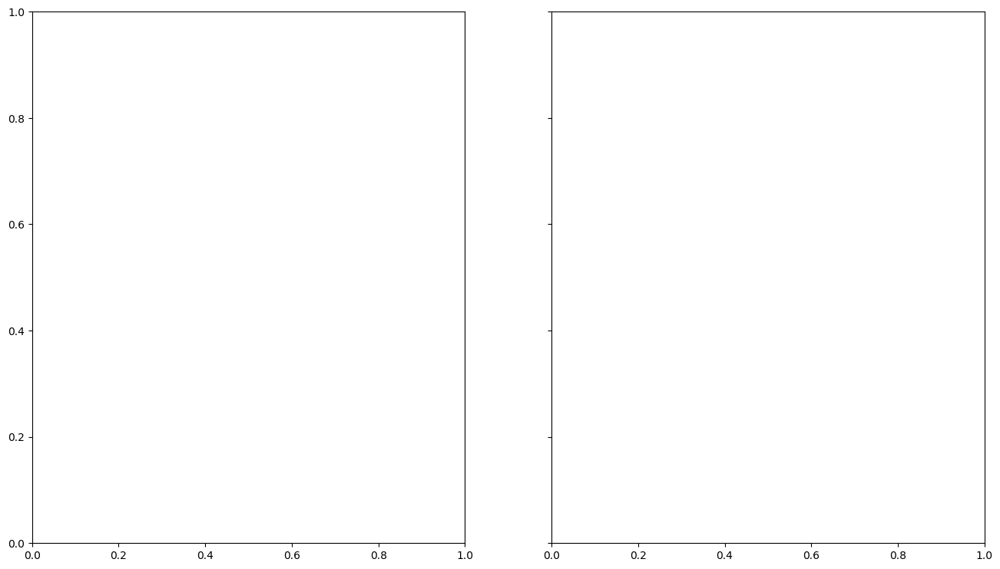

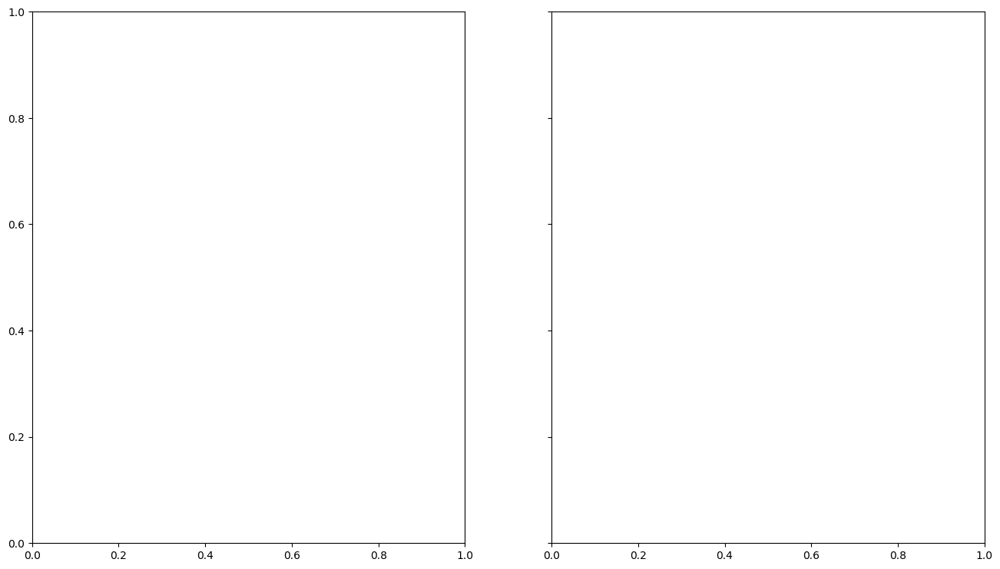

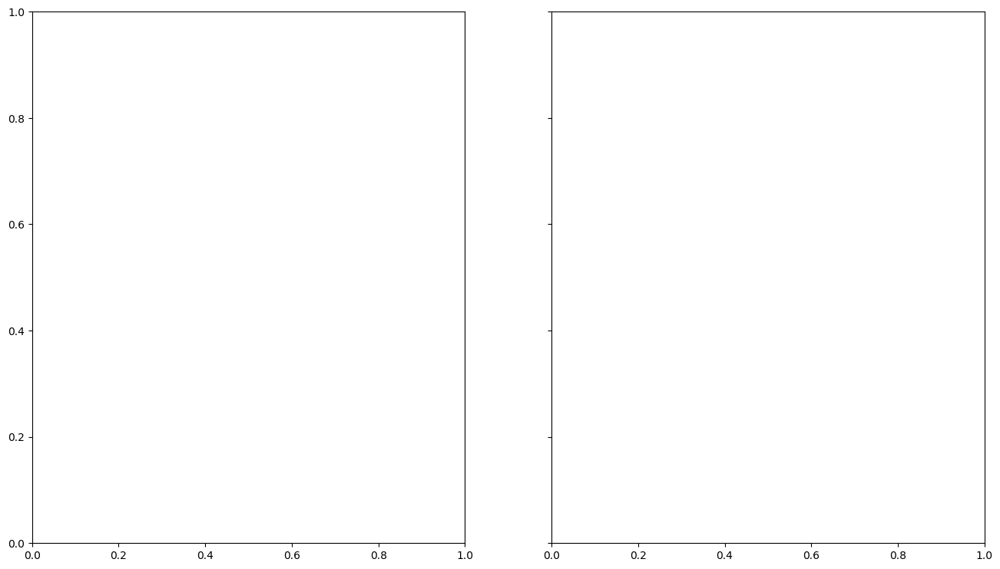

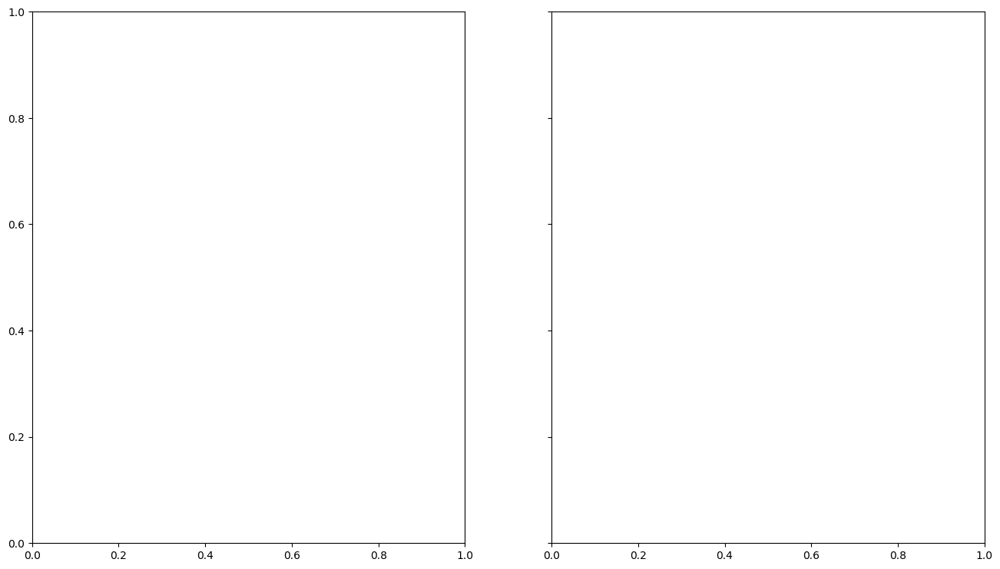

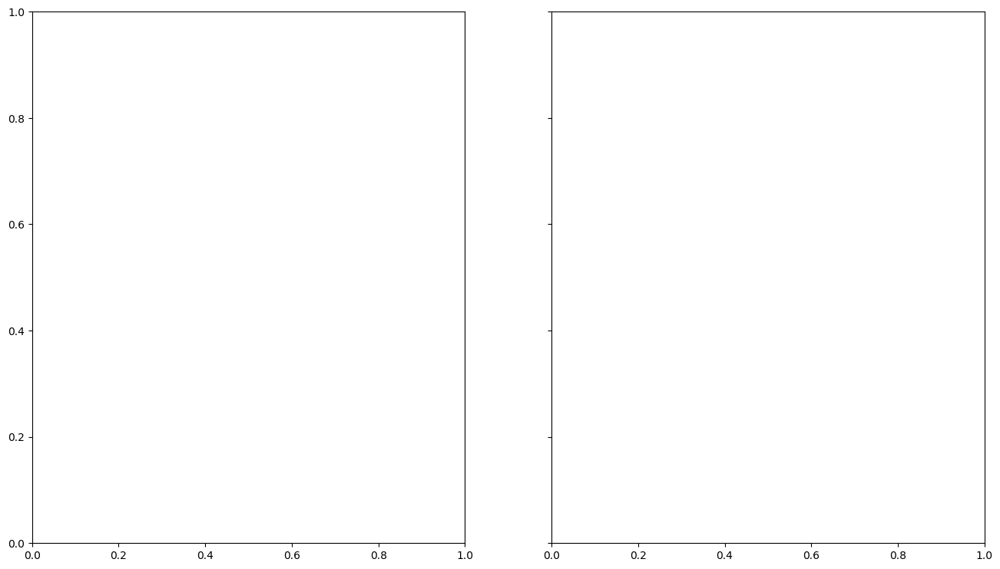

...

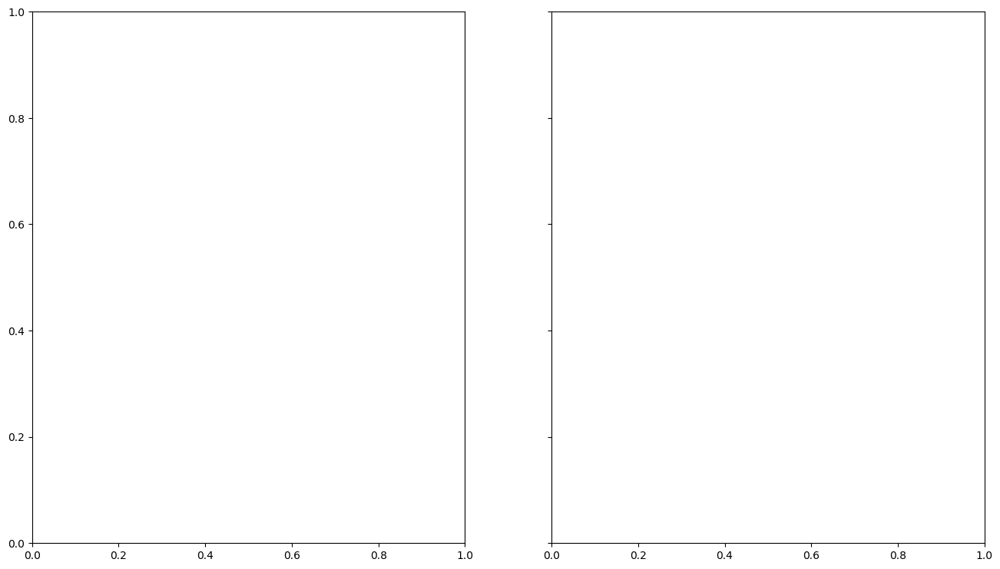

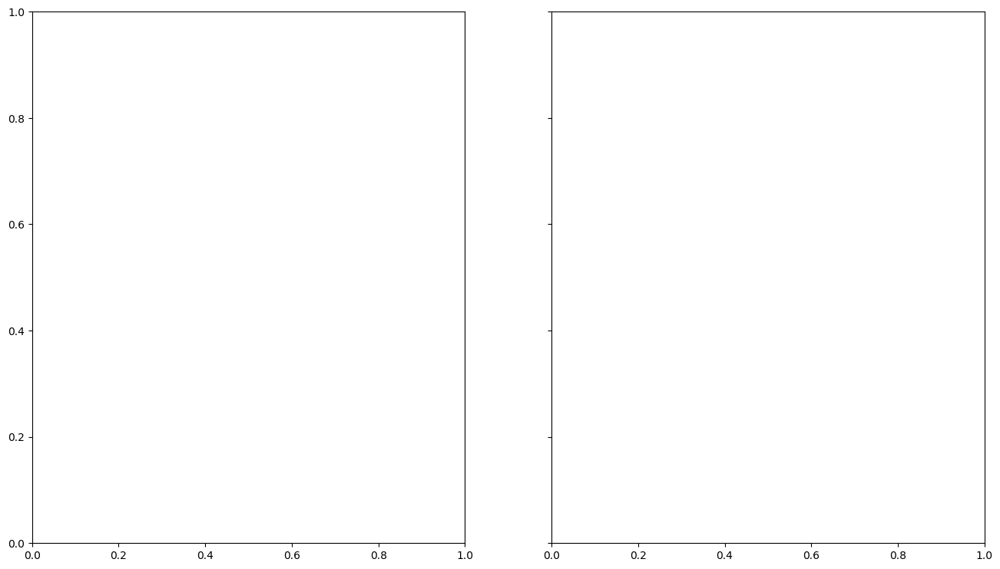

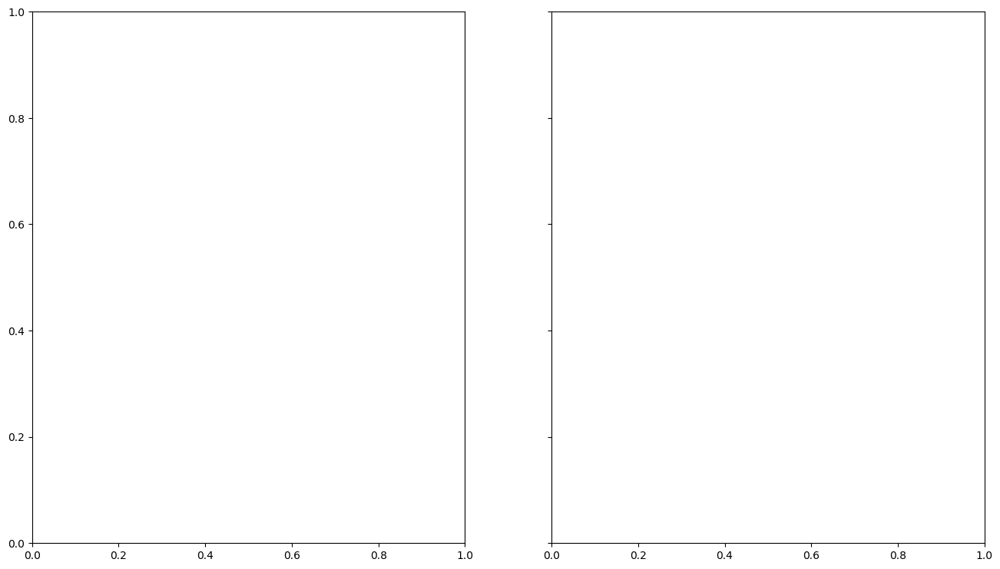

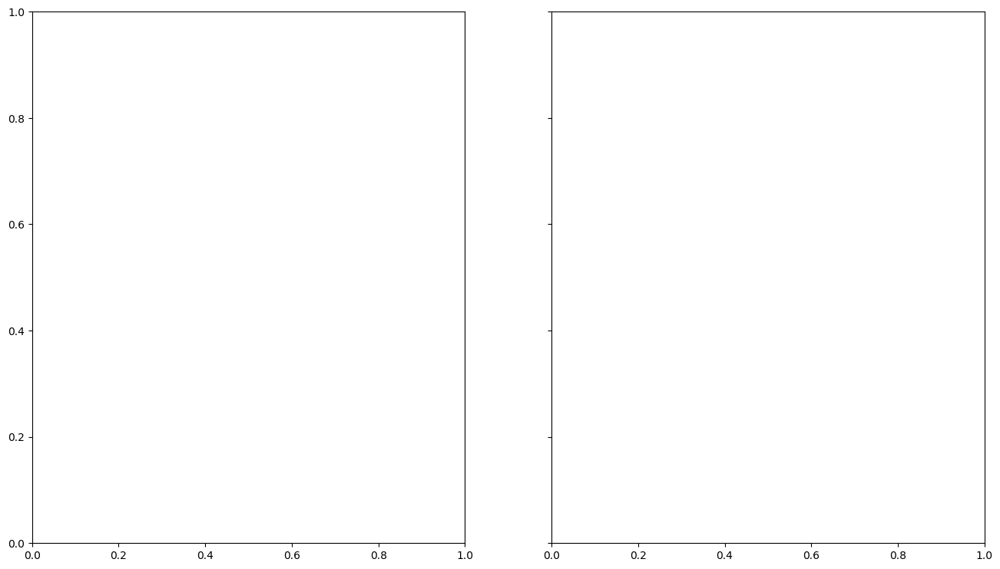

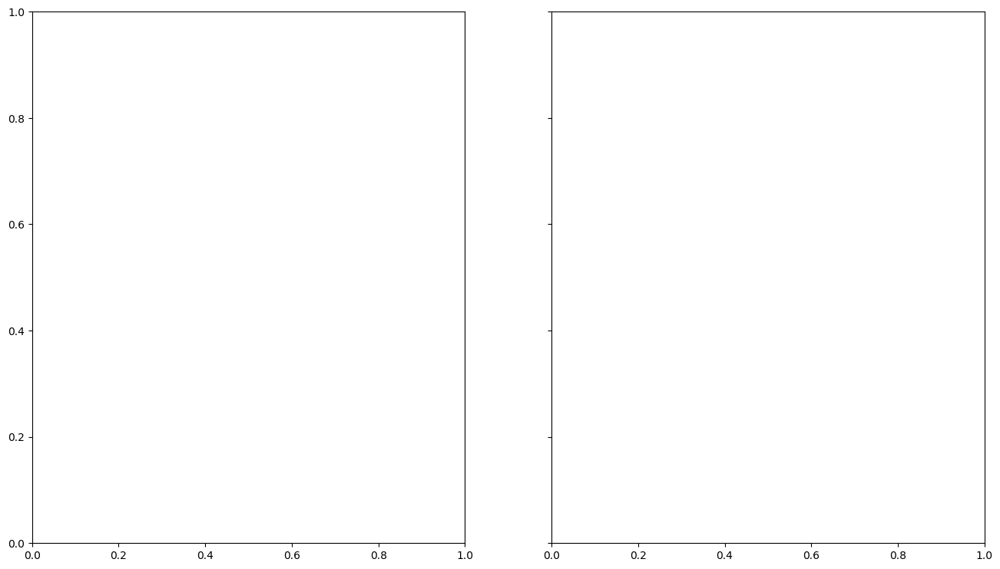

In [17]:
#Load DataSet
train_focus_path = "Testing_Focus_Images/"
train_outfocus_path = "Testing_Outfocus_Images/"

# Create data
array_one = main(train_focus_path)


z_0389.tif
z_0404.tif
z_0376.tif
z_0411.tif
z_0377.tif
z_0405.tif
z_0388.tif
z_0375.tif
z_0413.tif
z_0407.tif
z_0229.tif
z_0228.tif
z_0406.tif
z_0374.tif
z_0412.tif
z_0370.tif
z_0402.tif
.DS_Store
.DS_Store = 'NoneType' object has no attribute 'shape'
z_0238.tif
z_0239.tif
z_0013.tif
z_0403.tif
z_0371.tif
z_0398.tif
z_0401.tif
z_0373.tif
z_0372.tif
z_0400.tif
z_0399.tif
z_0248.tif
z_0240.tif
z_0241.tif
z_0243.tif
z_0243.tif = 'NoneType' object has no attribute 'shape'
z_0242.tif
z_0246.tif
z_0247.tif
z_0079.tif
z_0245.tif
z_0380.tif
z_0394.tif
z_0035.tif
z_0237.tif
z_0223.tif
z_0222.tif
z_0236.tif
z_0395.tif
z_0381.tif
z_0397.tif
z_0383.tif
z_0234.tif
z_0235.tif
z_0221.tif
z_0382.tif
z_0396.tif
z_0392.tif
z_0386.tif
z_0379.tif
z_0225.tif
z_0231.tif
z_0230.tif
z_0224.tif
z_0378.tif
z_0387.tif
z_0393.tif
z_0385.tif
z_0391.tif
z_0408.tif
z_0030.tif
z_0232.tif
z_0226.tif
z_0227.tif
z_0233.tif
z_0409.tif
z_0390.tif
z_0384.tif


[19,
 102,
 64,
 3,
 236,
 170,
 11,
 286,
 81,
 62,
 113,
 151,
 21,
 93,
 6,
 266,
 54,
 41,
 4,
 279,
 119,
 102,
 5,
 203,
 5,
 406,
 17,
 77,
 14,
 172,
 8,
 259,
 61,
 285,
 189,
 99,
 11,
 15,
 156,
 33,
 43,
 148,
 22,
 140,
 331,
 200,
 133,
 131,
 11,
 24,
 38,
 221,
 86,
 36,
 24,
 0,
 148,
 143,
 76,
 178,
 37,
 135,
 424,
 154,
 3,
 178,
 19,
 270,
 82,
 75,
 68,
 96,
 16,
 23,
 117,
 136,
 119,
 76,
 2,
 77,
 35,
 35,
 219,
 38,
 70,
 3,
 34,
 23,
 99,
 190,
 14,
 31,
 112,
 121,
 95,
 55,
 95,
 64,
 269,
 123,
 40,
 80,
 18,
 271,
 73,
 126,
 55,
 58,
 83,
 9,
 192,
 74,
 109,
 67,
 9,
 73,
 334,
 139,
 86,
 150,
 97,
 325,
 91,
 73,
 8,
 0,
 2,
 2,
 81,
 61,
 65,
 81,
 120,
 291,
 40,
 224,
 166,
 124,
 102,
 158,
 278,
 228,
 184,
 212,
 6,
 213,
 194,
 151,
 104,
 172,
 57,
 46,
 268,
 84,
 59,
 124,
 79,
 43,
 119,
 104,
 7,
 209,
 3,
 254,
 51,
 115,
 19,
 225,
 0,
 223,
 30,
 309,
 141,
 86,
 31,
 74,
 53,
 137,
 114,
 4,
 28,
 170,
 16,
 216,
 317,
 89,
 12,
 221,

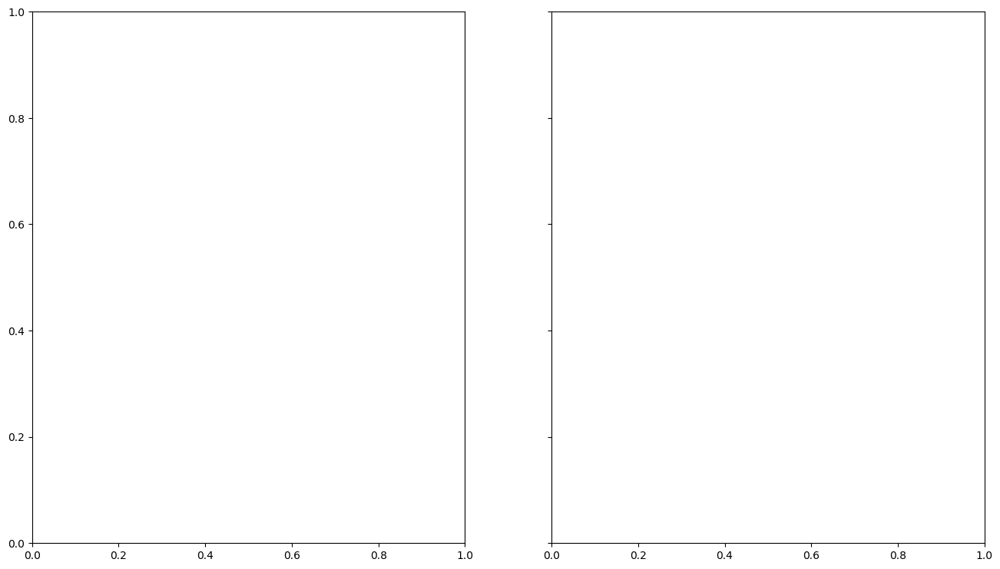

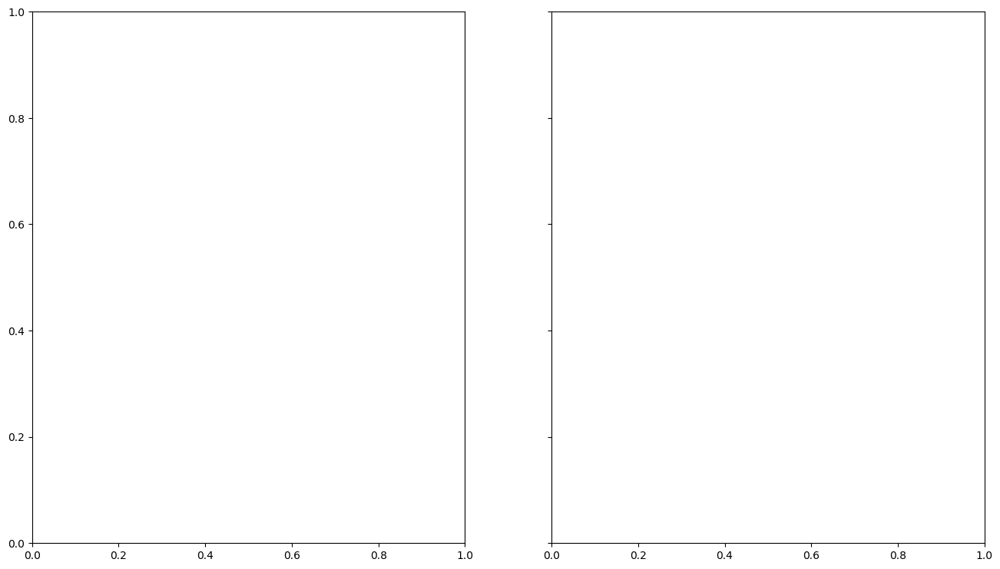

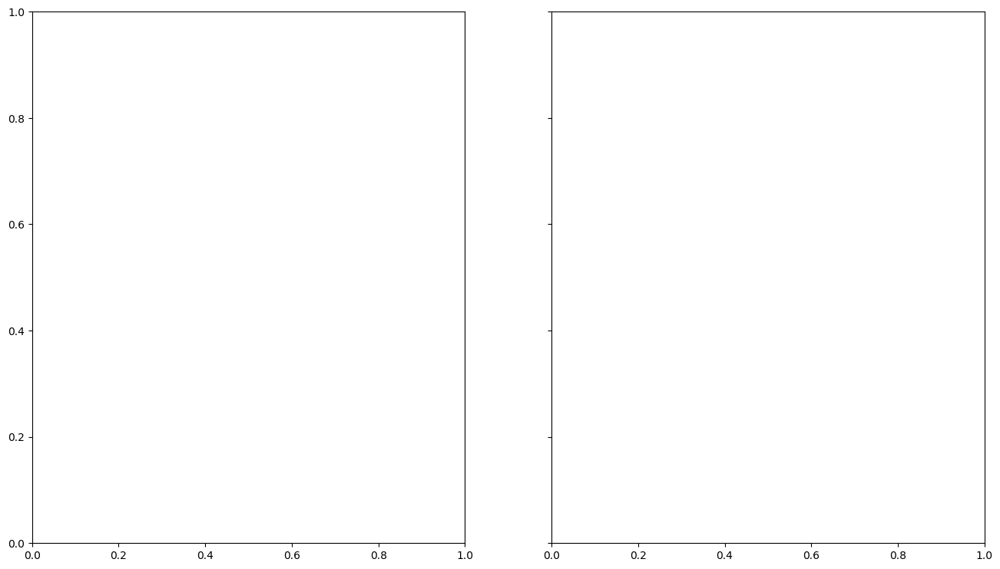

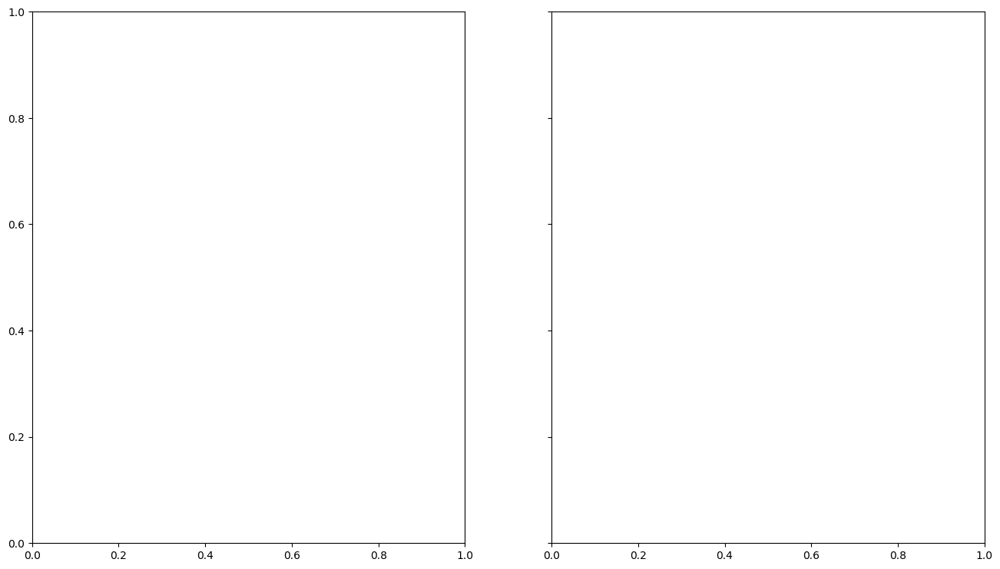

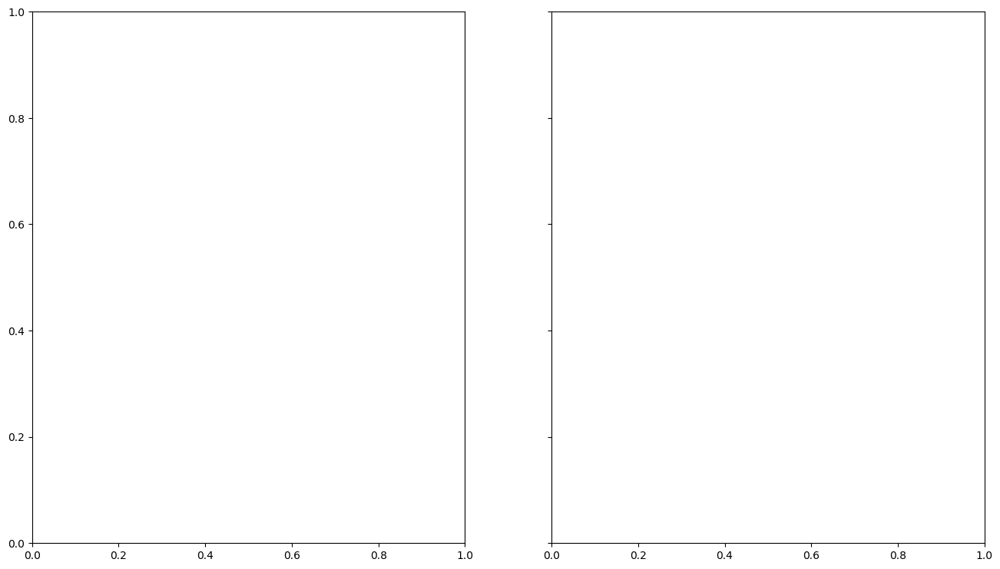

...

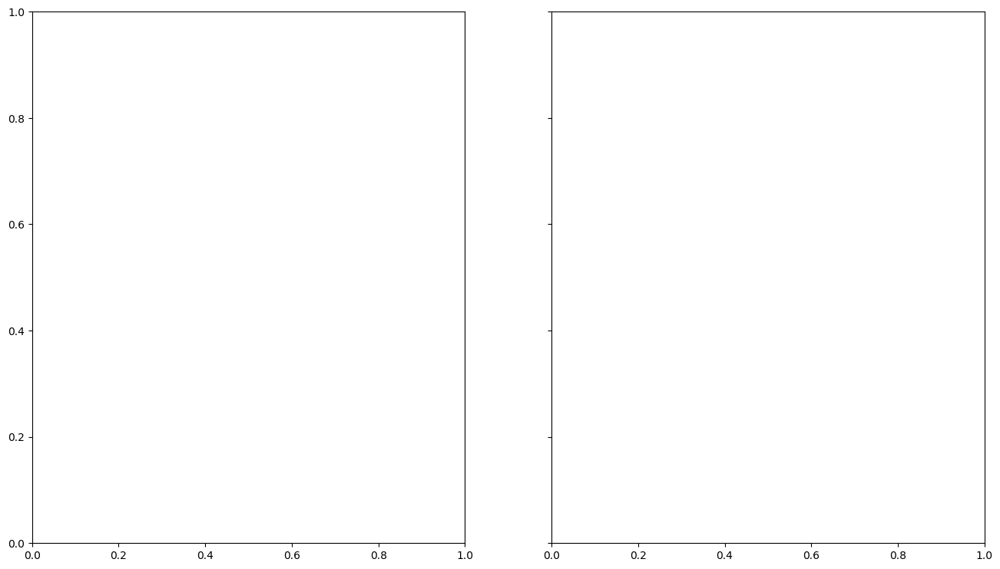

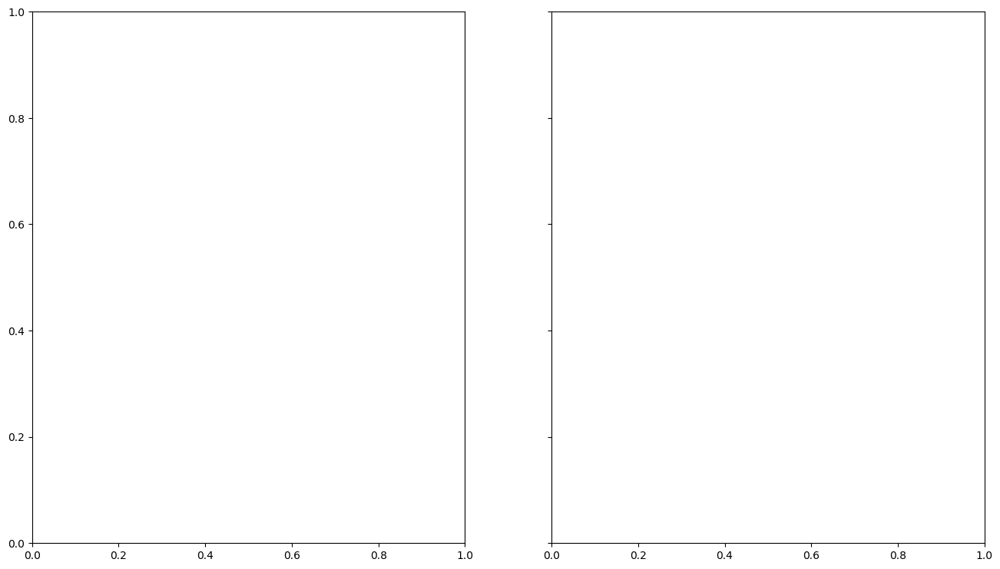

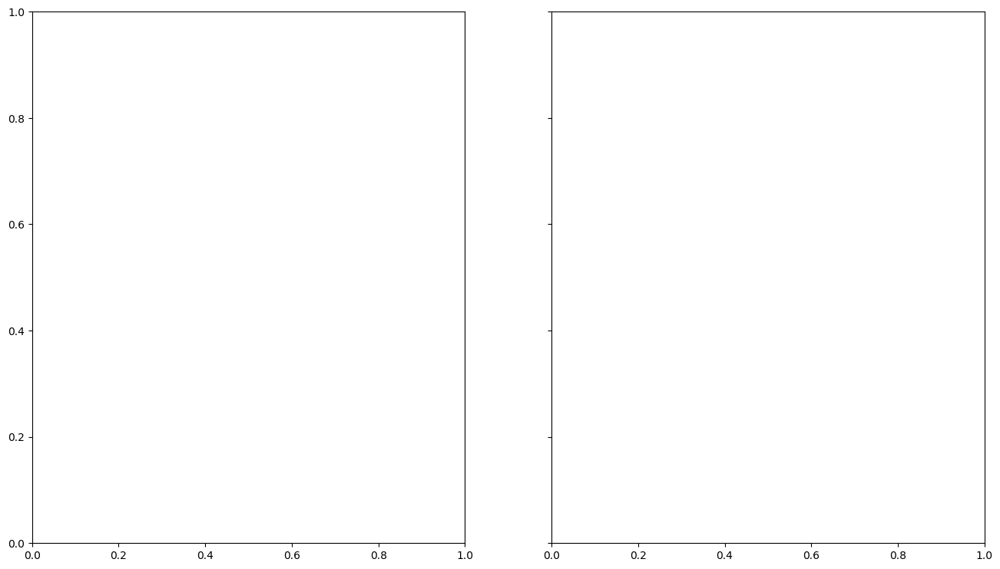

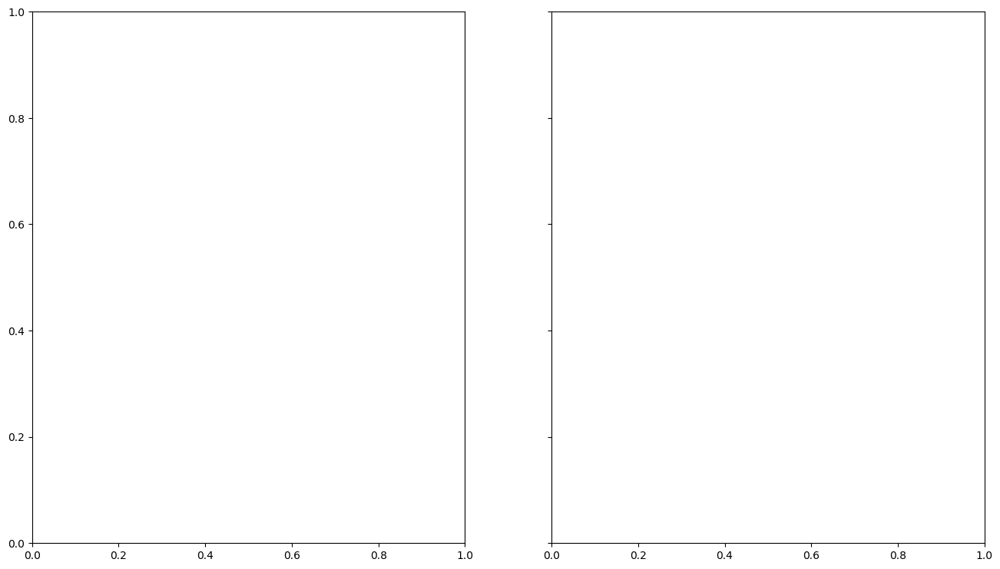

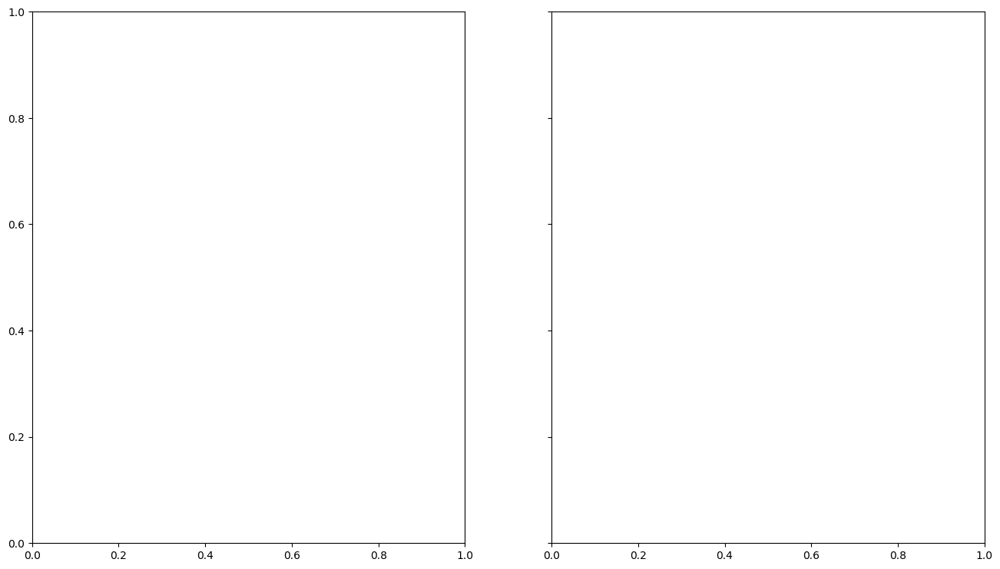

In [18]:
array = []
array_two = main("Testing_Outfocus_Images/")
array_two

In [19]:
import random 
y_one = []
for item in array_one:
    y_one.append(random.uniform(0, 1))
    
y_two = []
for item in array_two:
    y_two.append(random.uniform(0, 1))

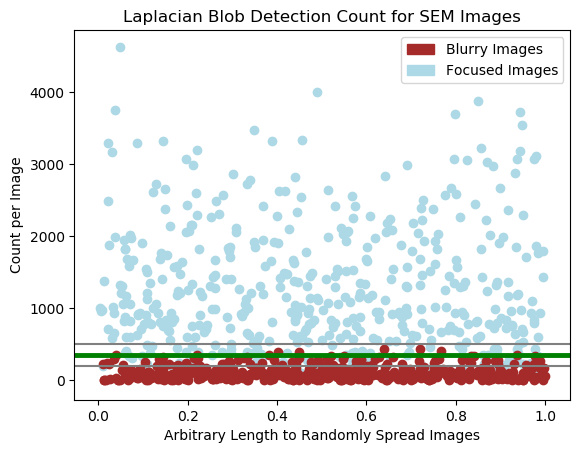

In [23]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

plt.scatter(y_one, array_one, color='lightblue')
plt.scatter(y_two, array_two, color='brown')
plt.xlabel('Arbitrary Length to Randomly Spread Images')
plt.ylabel('Count per Image')
plt.title(label='Laplacian Blob Detection Count for SEM Images')
brown_patch = mpatches.Patch(color='brown', label='Blurry Images')
blue_patch =mpatches.Patch(color='lightblue', label='Focused Images')
plt.axhline(y=350, color='green', linestyle='-', linewidth = 3.5)
plt.axhline(y=500, color='grey', linestyle='-')
plt.axhline(y=200, color='grey', linestyle='-')
plt.legend(handles=[brown_patch, blue_patch])

plt.show()

In [108]:
#The following code reads the image and performs laplacian of gaussian computer vision algorithm. 
#The graph is also created as a part of the function. 
from PIL import Image

def check_shape(image):
    image = cv2.imread(image)
    height, width, channels = image.shape 
    if (height*width > 330000000):
        return find_blobs_out(image, 7)
    else:
        gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
        _,thresh = cv2.threshold(gray,1,255,cv2.THRESH_BINARY)
        
        contours,hierarchy = cv2.findContours(thresh,cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
        cnt = contours[0]
        x,y,w,h = cv2.boundingRect(cnt)
    
        image = image[y:y+h,x:x+w]
        return find_blobs_focus(image, 7)

def splice_image(image, x, y):
    test = image
    my_slice = test[x:y, x:y]
    return my_slice

#Pick random number of positions in image and detects blobs 
def find_blobs_out(image, num):
    array = []
    height, width, channels = image.shape
    if(width>15000):
        image = cv2.resize(image, dsize=(10000, 10000), interpolation=cv2.INTER_LINEAR)
    placer = num - 1
    X = width/300
    Xfirst = 0
    Y = X+height/300
    Yfirst = X
    p =1
    for i in range(placer):
        x_pick = int(random.uniform(Xfirst, X))
        y_pick = int(random.uniform(Yfirst, Y))
        array.append(LOGandDOG(splice_image(image, x_pick, y_pick)))
        Xfirst = X
        Yfirst = Y
        X = X + width/300
        Y = X+height/300
        p = p + 1
    return array
        
def find_blobs_focus(image, num):
    array = []
    height, width, channels = image.shape
    placer = num - 1
    X = width/50
    Xfirst = 0
    Y = X+height/50
    Yfirst = X
    for i in range(placer):
        x_pick = int(random.uniform(Xfirst, X))
        y_pick = int(random.uniform(Yfirst, Y))
        array.append(LOGandDOG(splice_image(image, x_pick, y_pick)))
        Xfirst = X
        Yfirst = Y
        X = X + width/50
        Y = X+height/50
    return array


def LOGandDOG(image): 
    #Reading image
    #image = cv2.imread(image)
    
    blobsLOG = blob_log(rgb2gray(image), max_sigma=30, num_sigma=10, threshold=.1)

    # Computing radii
    blobsLOG[:, 2] = blobsLOG[:, 2] * sqrt(2)


    #Setting plot
    blobList = [blobsLOG]
    colors = ['yellow']
    titles = ['Laplacian of Gaussian']
    sequence = zip(blobList, colors, titles)

    fig, axes = plt.subplots(1, 2, figsize=(16, 9), sharex=True, sharey=True)

    ax = axes.ravel()
    
    #print("Loading image...")
    countofCircles = 0
    
    for index, (blobs, color, title) in enumerate(sequence):
        #ax[index].set_title(title)
        #ax[index].imshow(image, interpolation='nearest')
        for blob in blobs:
            y, x, r = blob
            #c = plt.Circle((x, y), r, color=color, linewidth=2, fill=False)
            countofCircles=countofCircles+1
            #ax[index].add_patch(c)
        #ax[index].set_axis_off()
        
    #plt.show()
    #print('This is the count for the number of Laplacian blobs: ', countofCircles)
    return countofCircles 

Tile_r1-c2_S_006_1144464749.tif
Tile_r1-c2_S_013_1065540928.tif
Tile_r2-c1_S_048_664422782.tif
Tile_r2-c1_S_035_1041836130.tif


/anaconda2/envs/model1/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Tile_r2-c1_S_005_590829419.tif
Tile_r2-c1_S_008_665196992.tif
Tile_r1-c1_S_010_1888429165.tif
Tile_r1-c2_S_011_1870302297.tif
Tile_r2-c2_S_005_590829419.tif
Tile_r2-c2_S_008_665196992.tif
Tile_r2-c2_S_003_2061330363.tif
Tile_r1-c2_S_005_590829419.tif
Tile_r1-c2_S_008_665196992.tif
Tile_r1-c1_S_046_710160544.tif
Tile_r2-c1_S_045_1186197535.tif
Tile_r1-c2_S_027_1218431233.tif
Tile_r2-c1_S_007_1607496485.tif
Tile_r2-c1_S_047_1169929506.tif
Tile_r1-c2_S_026_1356034610.tif
Tile_r1-c1_S_005_590829419.tif
Tile_r1-c1_S_008_665196992.tif
focus44.tif
Tile_r2-c2_S_027_1218431233.tif
Tile_r2-c2_S_030_1731500692.tif
Tile_r2-c1_S_029_147927860.tif
Tile_r1-c2_S_002_241398155.tif
Tile_r1-c1_S_047_1169929506.tif
Tile_r1-c1_S_007_1607496485.tif
Tile_r1-c1_S_001_296876213.tif
Tile_r2-c1_S_043_561399460.tif
Tile_r1-c2_S_001_296876213.tif
Tile_r1-c1_S_002_241398155.tif
Tile_r2-c2_S_001_296876213.tif
Tile_r2-c2_S_011_1870302297.tif
focus3.tif
Tile_r2-c2_S_015_1590718798.tif
Tile_r2-c1_S_002_241398155.tif
Ti

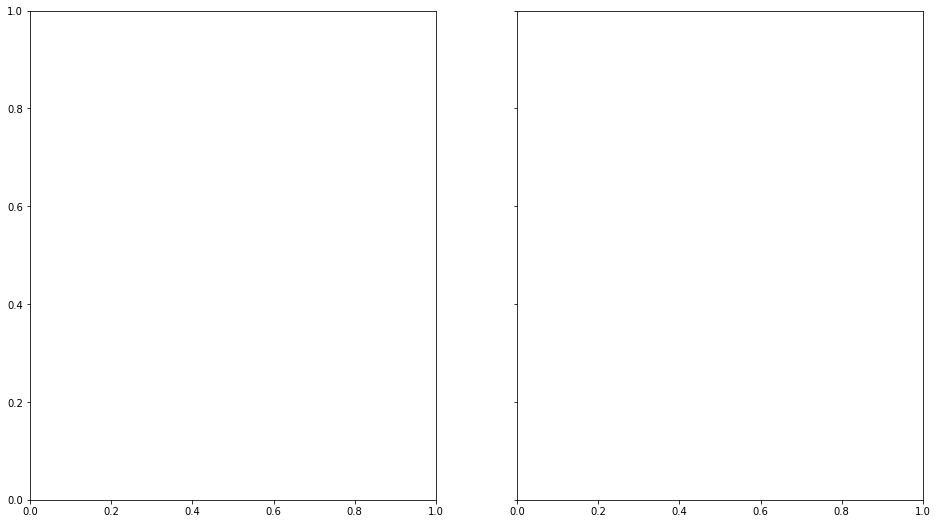

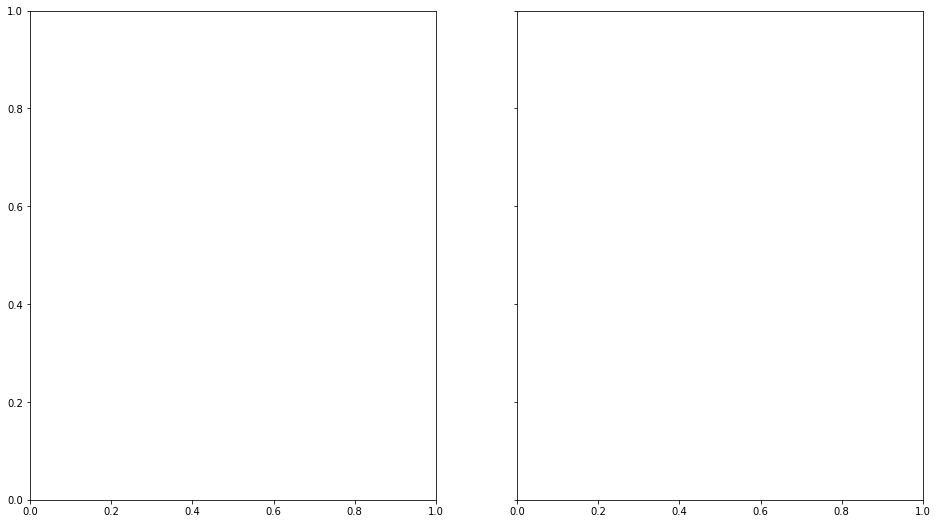

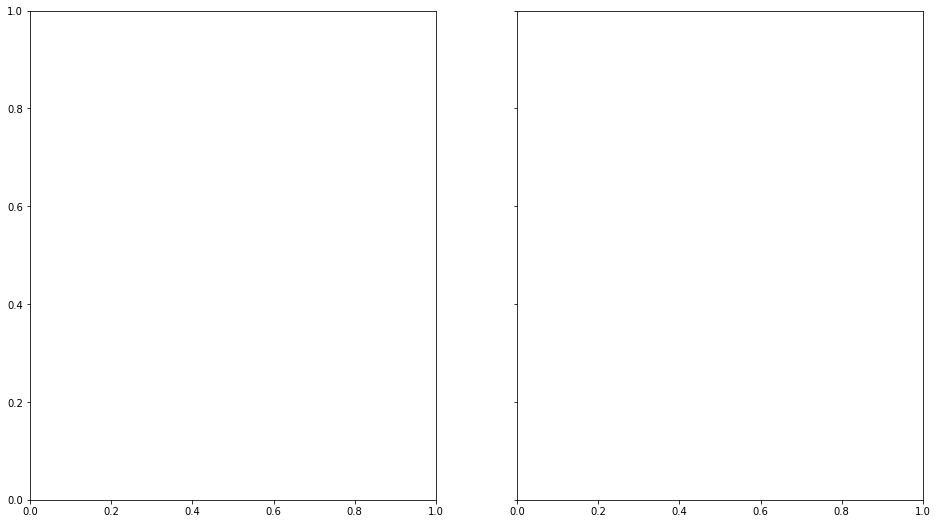

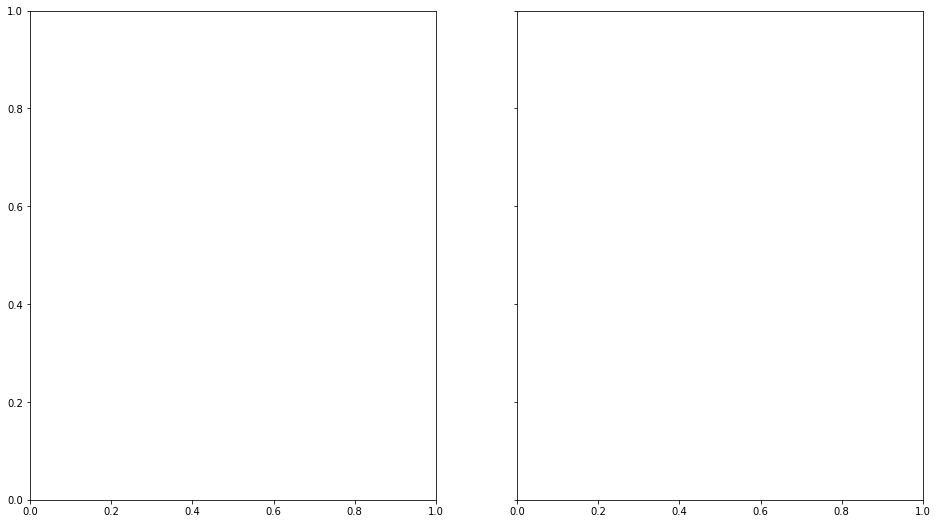

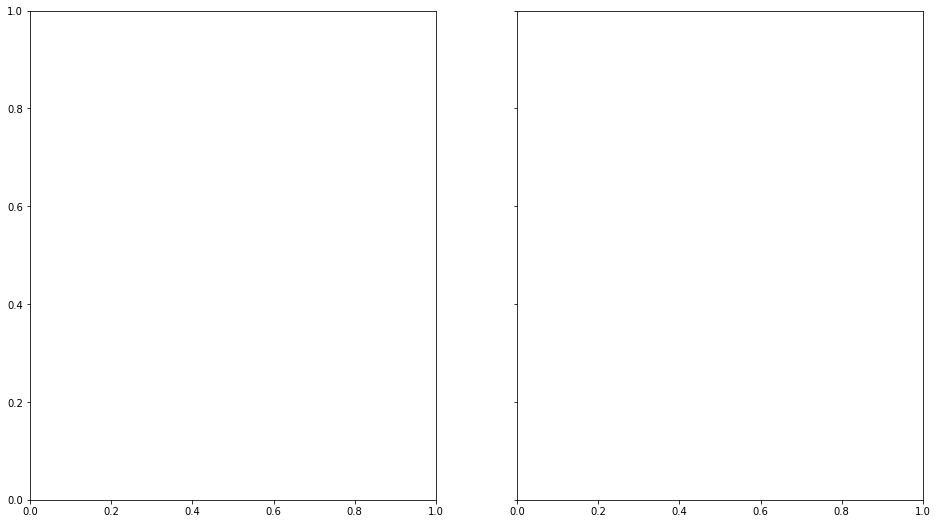

...

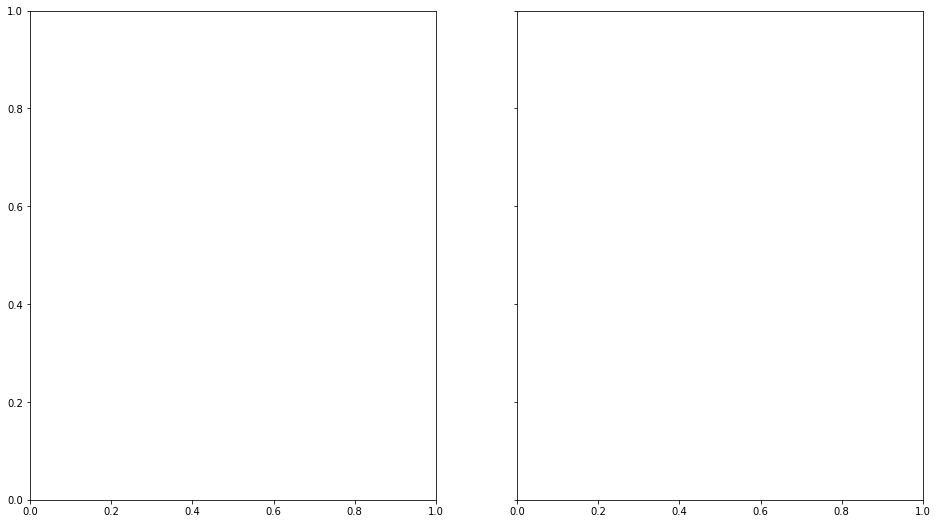

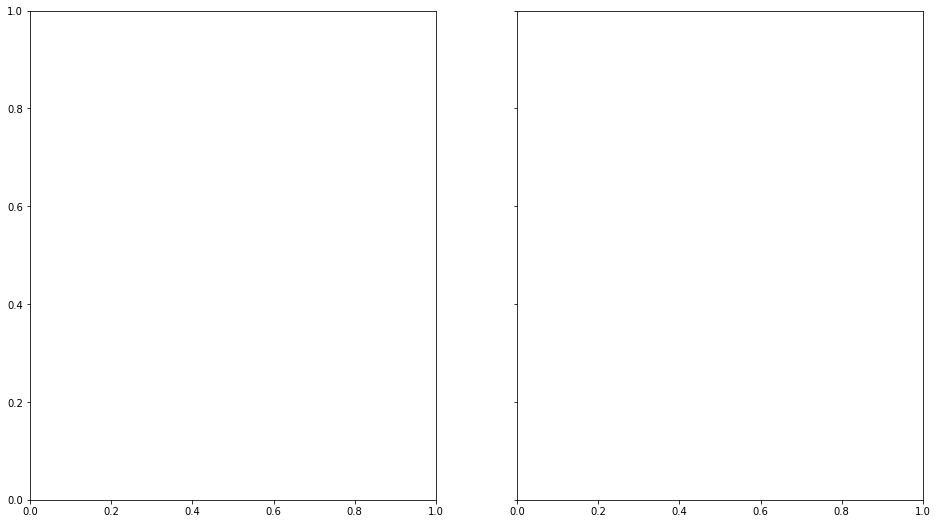

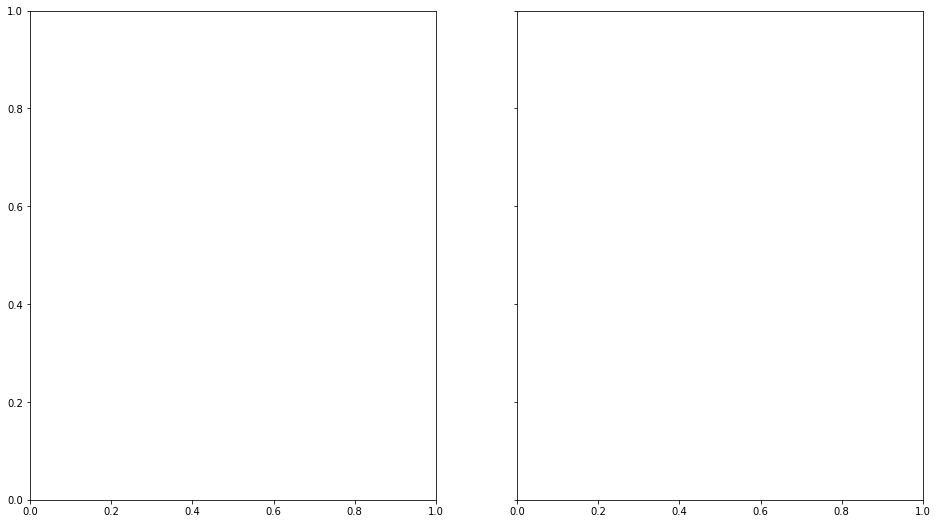

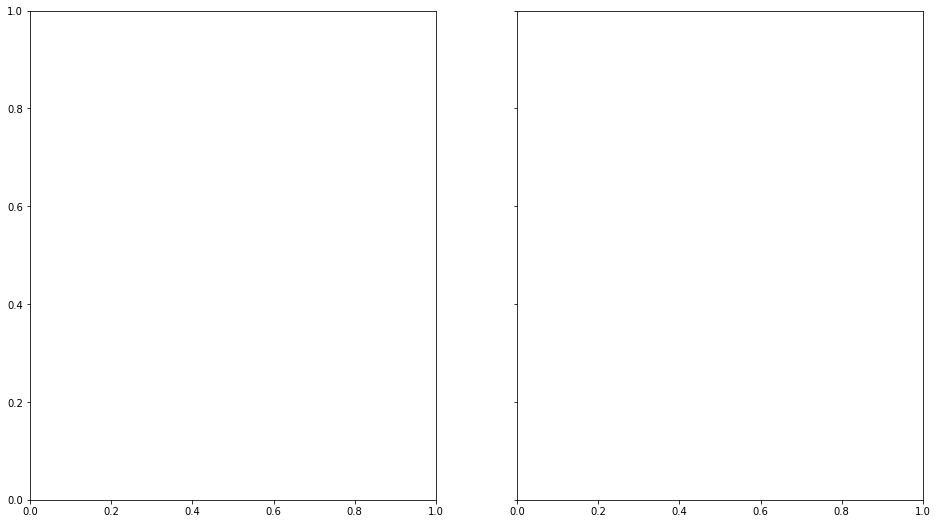

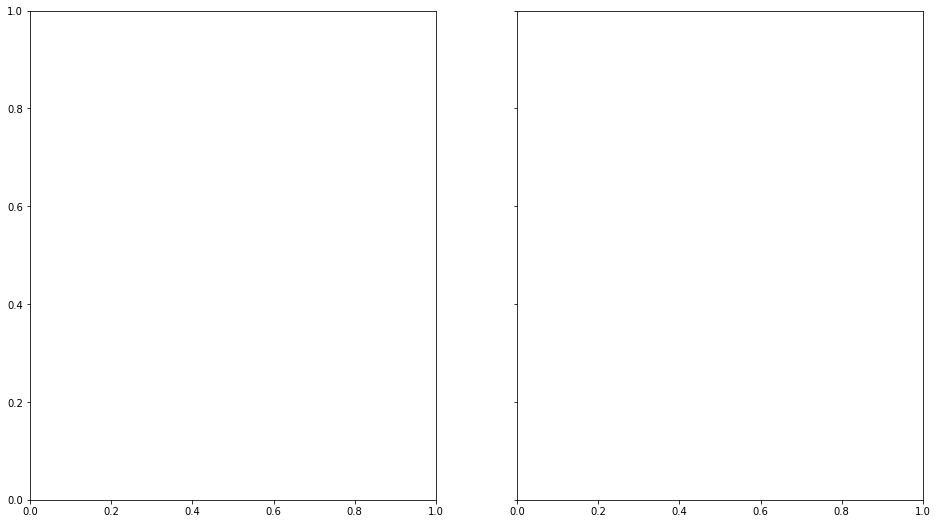

In [109]:
X = []
train_path = "Testing_Focus_Images/"
for filename in os.listdir(train_path):
    imagepath = train_path + filename
    try:
        print(filename)
        X.append(check_shape(imagepath))
    except:
        print(filename +" = 'NoneType' object has no attribute 'shape'")
        continue 
one = X

z_0389.tif
z_0404.tif
z_0376.tif
z_0411.tif
z_0377.tif
z_0405.tif
z_0388.tif
z_0375.tif
z_0413.tif
z_0407.tif
z_0229.tif
z_0228.tif
z_0406.tif
z_0374.tif
z_0412.tif
z_0370.tif
z_0402.tif
z_0238.tif
z_0239.tif
z_0013.tif
z_0403.tif
z_0371.tif
z_0398.tif
z_0401.tif
z_0373.tif
z_0372.tif
z_0400.tif
z_0399.tif
z_0248.tif
z_0240.tif
z_0241.tif
z_0243.tif
z_0242.tif
z_0246.tif
z_0247.tif
z_0079.tif
z_0245.tif
z_0380.tif
z_0394.tif
z_0035.tif
z_0237.tif
z_0223.tif
z_0222.tif
z_0236.tif
z_0395.tif
z_0381.tif
z_0397.tif
z_0383.tif
z_0234.tif
z_0235.tif
z_0221.tif
z_0382.tif
z_0396.tif
z_0392.tif
z_0386.tif
z_0379.tif
z_0225.tif
z_0231.tif
z_0231.tif = 'NoneType' object has no attribute 'shape'
z_0230.tif
z_0224.tif
z_0378.tif
z_0387.tif
z_0393.tif
z_0385.tif
z_0391.tif
z_0408.tif
z_0030.tif
z_0232.tif
z_0226.tif
z_0227.tif
z_0233.tif
z_0409.tif
z_0390.tif
z_0384.tif


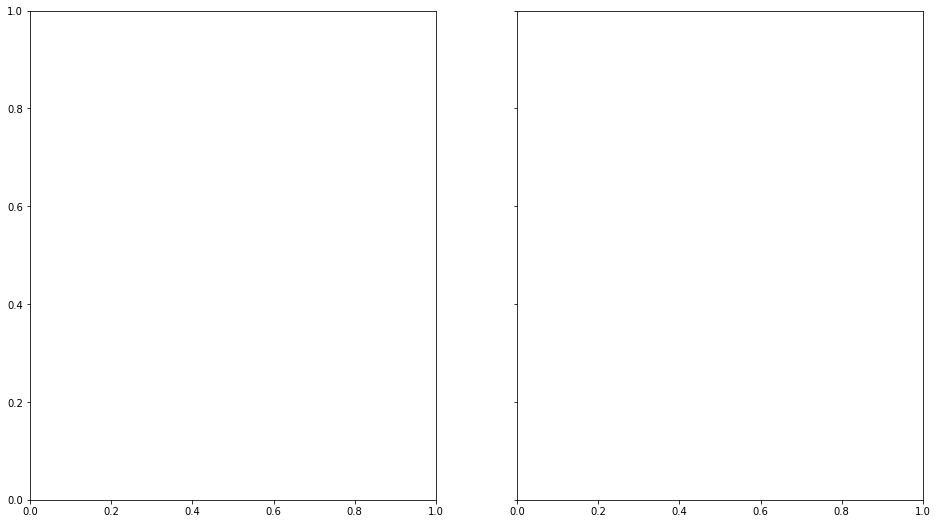

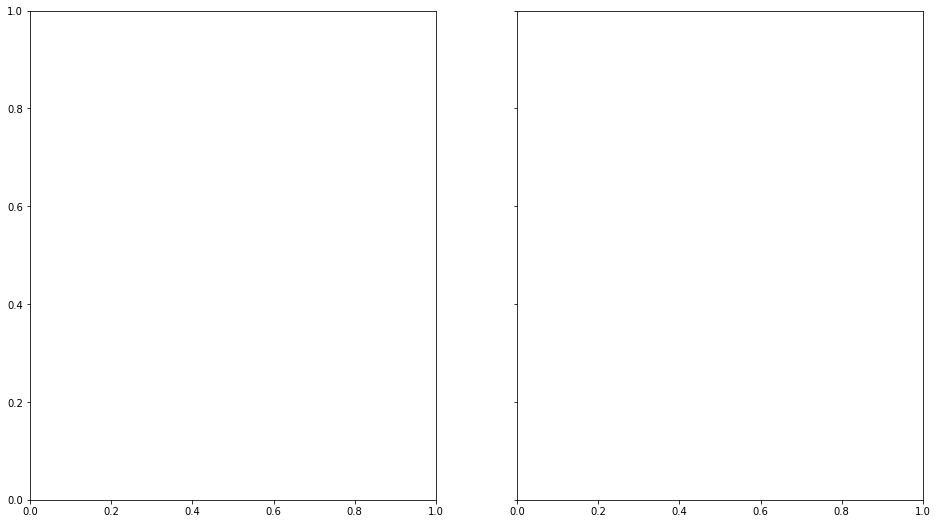

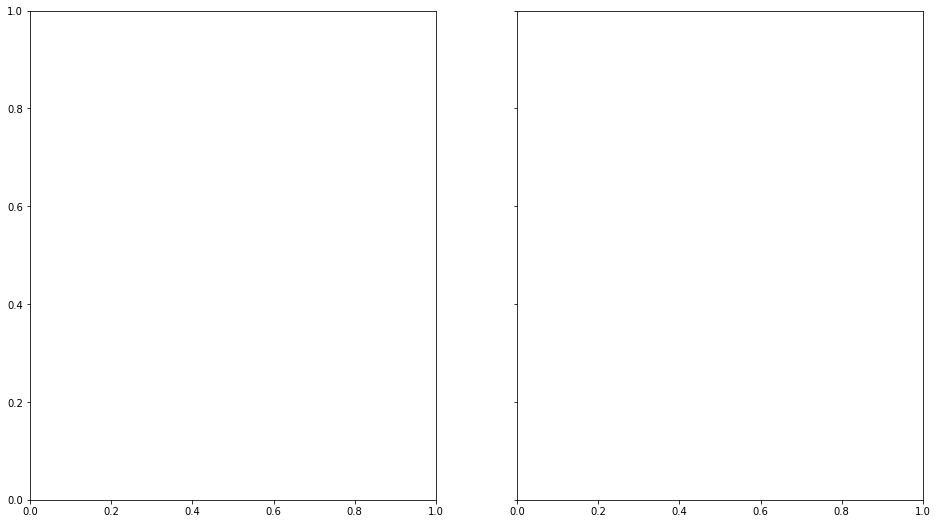

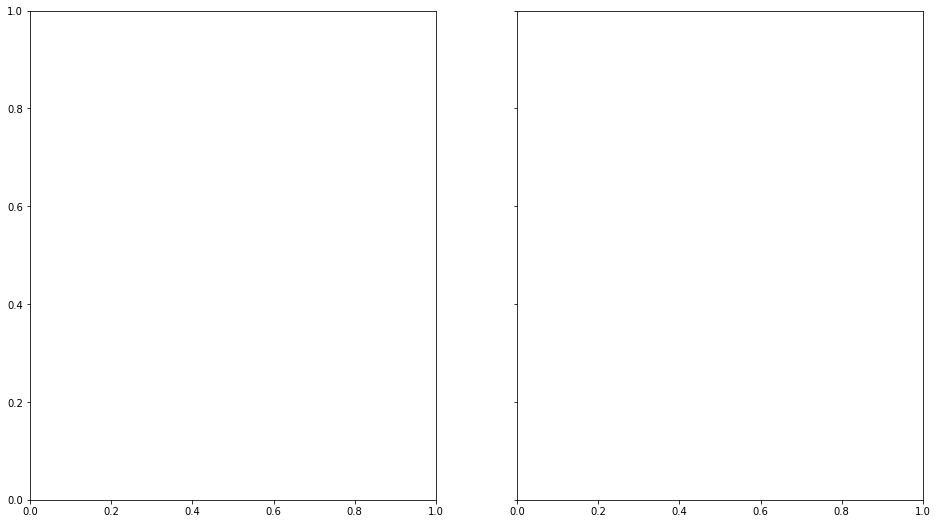

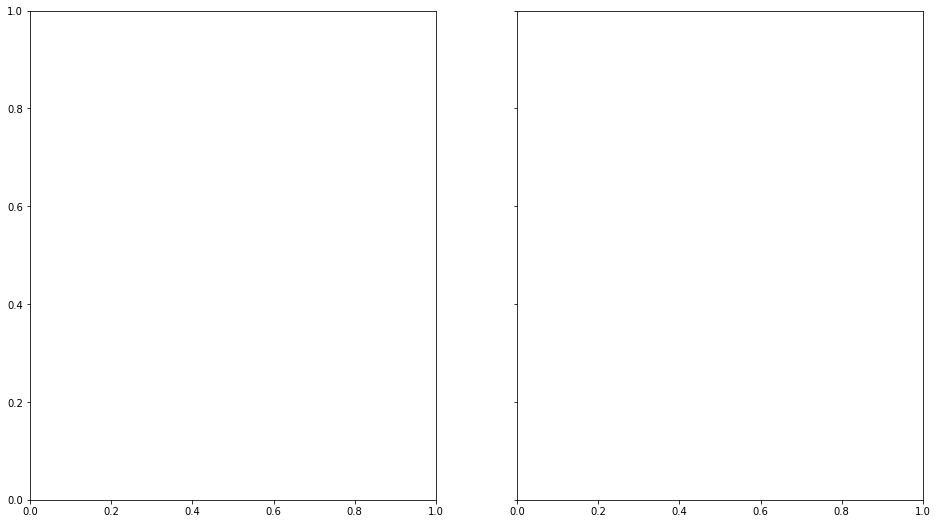

...

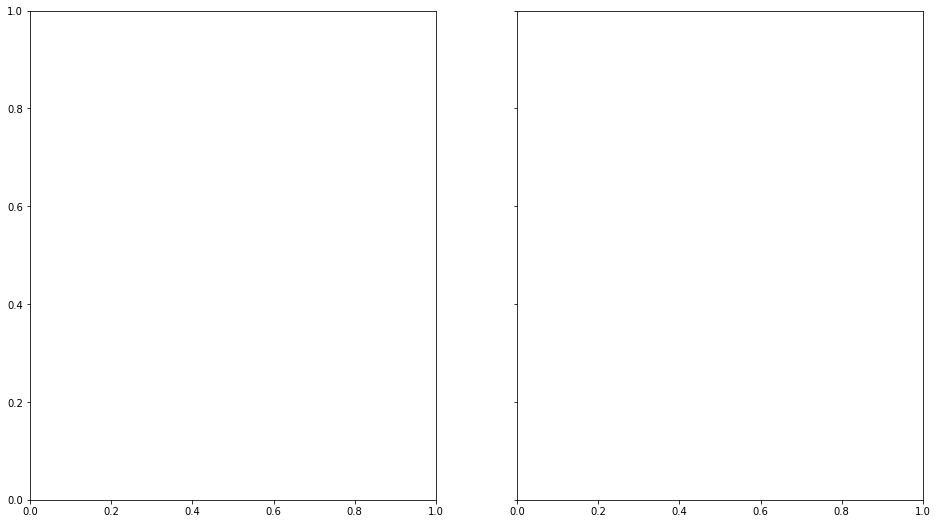

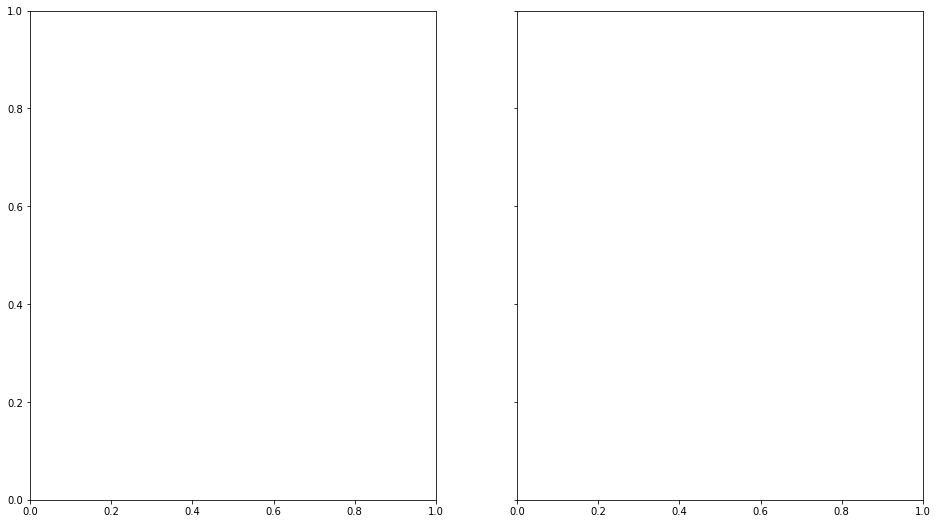

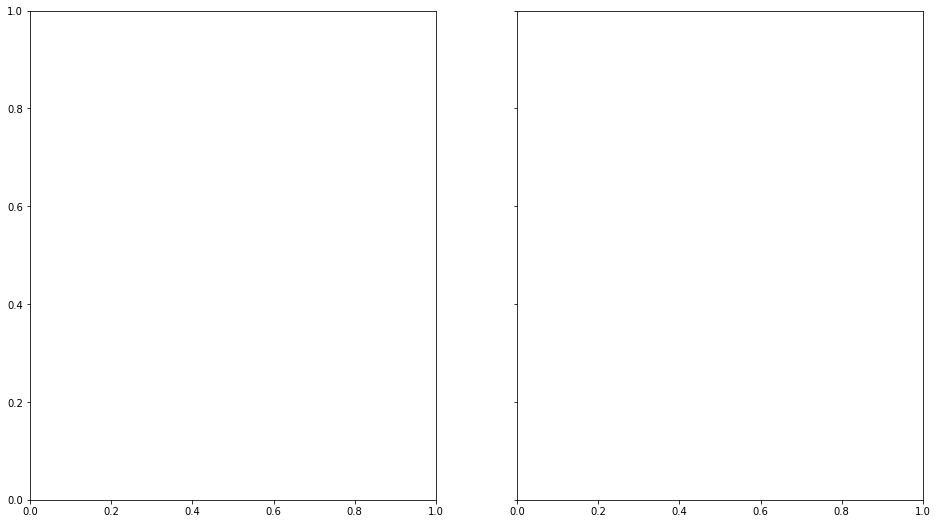

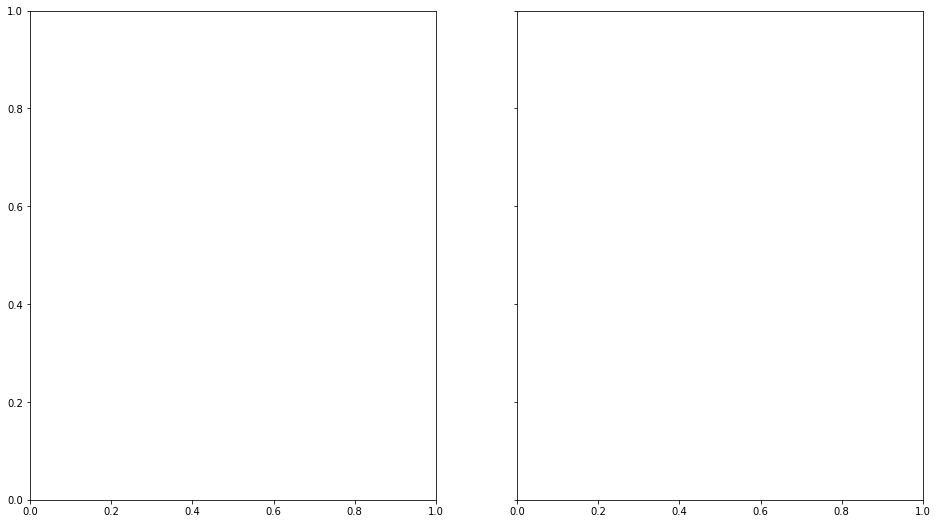

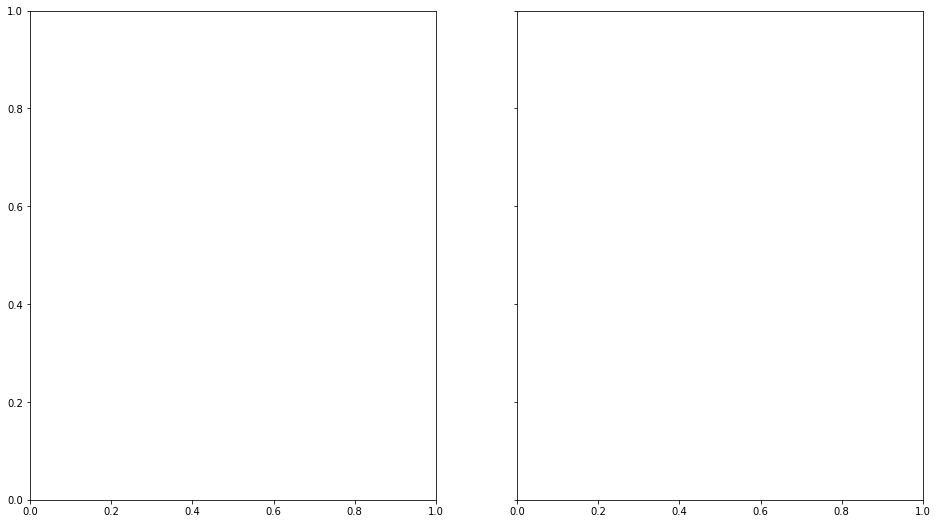

In [110]:
Y = []
i=0
train_path = "Testing_Outfocus_Images/"
for filename in os.listdir(train_path):
    if(i<162):
        imagepath = train_path + filename
        try:
            print(filename)
            Y.append(check_shape(imagepath))
        except:
            print(filename +" = 'NoneType' object has no attribute 'shape'")
            continue 
        i = i+1  
two = Y

# PCA Using Sklearn 

In [111]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [112]:
df = pd.DataFrame(columns = ['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'Type'])
for arr in X:
    df = df.append({'B1': arr[0], 'B2': arr[1], 'B3': arr[2], 'B4': arr[3], 'B5': arr[4], 'B6': arr[5],'Type': 'Focused'}, ignore_index=True)
for arr in Y:
    df = df.append({'B1': arr[0], 'B2': arr[1], 'B3': arr[2], 'B4': arr[3], 'B5': arr[4], 'B6': arr[5],'Type': 'Blurry'}, ignore_index=True)

In [113]:
df

,B1,B2,B3,B4,B5,B6,Type
0,499,1441,2861,1093,2432,188,Focused
1,399,2716,1753,909,2070,589,Focused
2,2059,3238,1508,649,999,346,Focused
3,371,283,646,260,657,775,Focused
4,550,720,1463,1171,981,430,Focused
5,32,255,377,1045,1103,496,Focused
6,2004,1450,448,1081,289,1379,Focused
7,771,817,715,664,318,1279,Focused
8,770,169,622,186,1119,3798,Focused
9,575,1700,349,1306,1407,2550,Focused


In [115]:
features = ['B1', 'B2', 'B3', 'B4', 'B5', 'B6']
# Separating out the features
x = df.loc[:, features].values
# Separating out the target
y = df.loc[:,['Type']].values
# Standardizing the features
x = StandardScaler().fit_transform(x)

/anaconda2/envs/model1/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype object was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/anaconda2/envs/model1/lib/python3.7/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype object was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


In [131]:
array_cov = np.reshape(x, (6,153))
array_cov = np.cov(array_cov)
array_cov.shape

(6, 6)

In [132]:
array_cov

array([[ 1.13663327e+00, -2.35191445e-02,  4.02469522e-02,
        -4.92194084e-03, -2.94629465e-03,  6.97148399e-03],
       [-2.35191445e-02,  8.08532370e-01, -4.12718284e-03,
        -4.81530239e-02,  8.97804386e-03, -1.04056431e-02],
       [ 4.02469522e-02, -4.12718284e-03,  1.13200498e+00,
        -5.62697206e-05,  1.63355585e-02,  6.98139369e-03],
       [-4.92194084e-03, -4.81530239e-02, -5.62697206e-05,
         5.31522904e-01,  1.14076302e-03,  3.17813491e-03],
       [-2.94629465e-03,  8.97804386e-03,  1.63355585e-02,
         1.14076302e-03,  7.79480464e-03, -1.28537116e-03],
       [ 6.97148399e-03, -1.04056431e-02,  6.98139369e-03,
         3.17813491e-03, -1.28537116e-03,  1.23453058e-02]])

In [133]:
cov_df = pd.DataFrame(columns = ['B1', 'B2', 'B3', 'B4', 'B5', 'B6'])
for arr in array_cov:
    cov_df = cov_df.append({'B1': arr[0], 'B2': arr[1], 'B3': arr[2], 'B4': arr[3], 'B5': arr[4], 'B6': arr[5]}, ignore_index=True)

In [135]:
cov_df.index = ['B1', 'B2', 'B3', 'B4', 'B5', 'B6']
cov_df

,B1,B2,B3,B4,B5,B6
B1,1.136633,-0.023519,0.040247,-0.004922,-0.002946,0.006971
B2,-0.023519,0.808532,-0.004127,-0.048153,0.008978,-0.010406
B3,0.040247,-0.004127,1.132005,-0.000056,0.016336,0.006981
B4,-0.004922,-0.048153,-0.000056,0.531523,0.001141,0.003178
B5,-0.002946,0.008978,0.016336,0.001141,0.007795,-0.001285
B6,0.006971,-0.010406,0.006981,0.003178,-0.001285,0.012345


In [145]:
eigenval, eigenvect = np.linalg.eig(array_cov)
eigenval_df = pd.DataFrame(columns = ['1', '2', '3', '4', '5', '6'])
eigenvect_df = pd.DataFrame(columns = ['1', '2', '3', '4', '5', '6'])

In [148]:
arr = eigenval
eigenval_df = eigenval_df.append({'1': arr[0], '2': arr[1], '3': arr[2], '4': arr[3], '5': arr[4], '6': arr[5]}, ignore_index=True)

In [149]:
eigenval_df

,1,2,3,4,5,6
0,1.175877,1.094792,0.815325,0.523283,0.012434,0.007123


In [163]:
for arr in eigenvect:
    eigenvect_df = eigenvect_df.append({'1': arr[0], '2': arr[1], '3': arr[2], '4': arr[3], '5': arr[4], '6': arr[5]}, ignore_index=True)

In [162]:
eigenvect_df

,1,2,3,4,5,6
0,-0.731141,0.678516,-0.069300,-0.014318,0.006278,0.001394
1,0.054327,-0.045257,-0.983181,-0.167534,-0.014986,-0.007986
2,-0.679961,-0.733068,-0.003715,-0.000112,0.002199,-0.015675
3,0.001528,-0.002013,0.168121,-0.985745,0.004069,-0.004312
4,-0.007236,-0.013232,-0.010536,-0.005014,0.244376,0.969493
5,-0.008934,0.000087,0.012789,-0.002904,-0.969533,0.244445


In [167]:
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2', 'principal component 3' ])

In [168]:
finalDf = pd.concat([principalDf, df[['Type']]], axis = 1)

In [228]:
#%matplotlib notebook

<IPython.core.display.Javascript object>


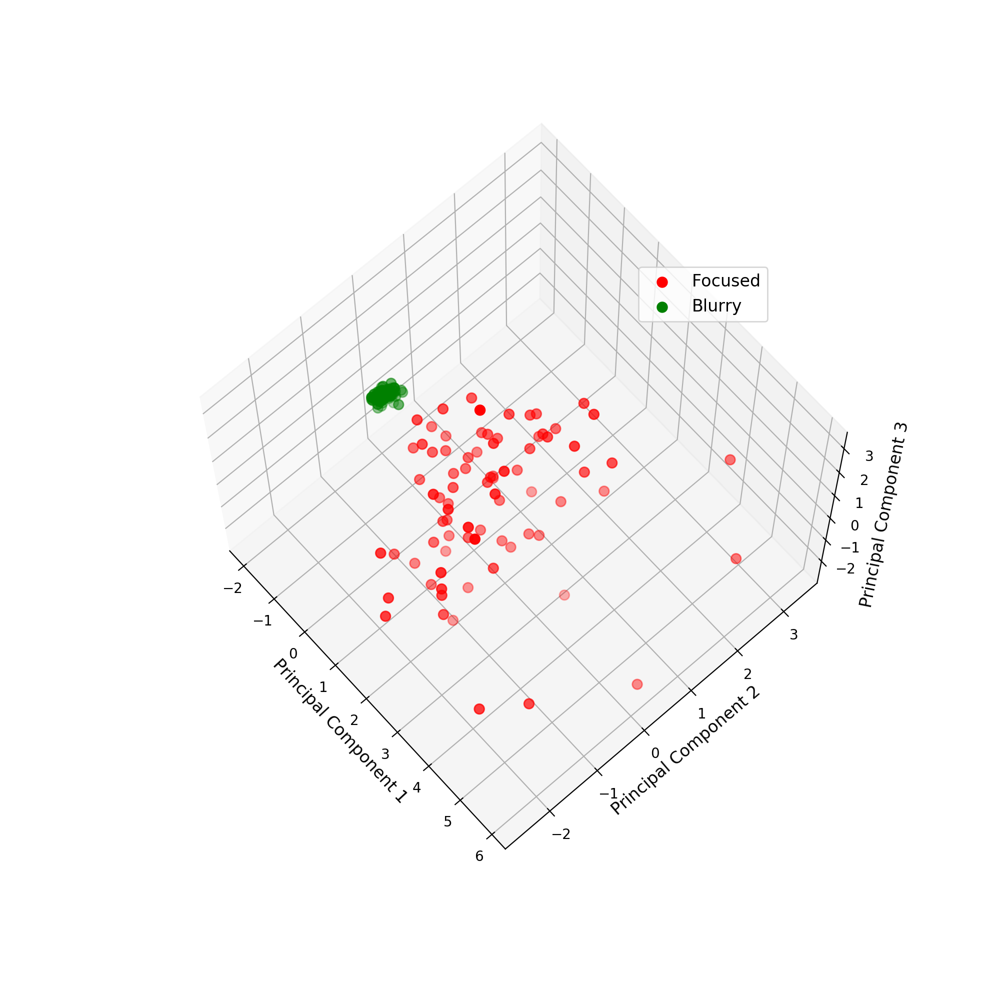

In [230]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize = (10,10))
ax = fig.add_subplot(111, projection='3d') 
ax.set_xlabel('Principal Component 1', fontsize = 12)
ax.set_ylabel('Principal Component 2', fontsize = 12)
ax.set_zlabel('Principal Component 3', fontsize = 12)
#ax.set_title('2 Component Principal Component Analysis (PCA)', fontsize = 13)
targets = ['Focused', 'Blurry']
colors = ['r', 'g', 'b']
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['Type'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2'], finalDf.loc[indicesToKeep, 'principal component 3']
               , c = color
               , s = 50, zdir='z')
ax.legend(targets, loc = 'upper right', bbox_to_anchor=(0.84, 0.82), fontsize = 'large')
    
ax.grid()

In [ ]:
import scikitplot as skplt
import matplotlib.pyplot as plt

y_true = # ground truth labels
y_probas = # predicted probabilities generated by sklearn classifier
skplt.metrics.plot_roc_curve(y_true, y_probas)
plt.show()